In [54]:
 #pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [55]:
#pip install plotly --upgrade

In [56]:
#!pip install pyyaml==5.4.1

In [57]:
#from google.colab import files
#uploaded = files.upload()

In [58]:
#!pip install -q condacolab
#import condacolab
#condacolab.install()

In [59]:
#!conda --version

In [60]:
#!pip install xgboost

In [61]:
import numpy as np
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
%matplotlib inline
import plotly.express as px
import pandas_profiling as pp
import folium

In [62]:
#import io
#df = pd.read_csv(io.BytesIO(uploaded['hotel_booking.csv']))
df = pd.read_csv('hotel_booking.csv')

In [63]:
df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,name,email,phone-number,credit_card
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,3,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01,Ernest Barnes,Ernest.Barnes31@outlook.com,669-792-1661,************4322
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,4,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01,Andrea Baker,Andrea_Baker94@aol.com,858-637-6955,************9157
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Direct,Direct,0,0,0,A,C,0,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02,Rebecca Parker,Rebecca_Parker@comcast.net,652-885-2745,************3734
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Corporate,Corporate,0,0,0,A,A,0,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02,Laura Murray,Laura_M@gmail.com,364-656-8427,************5677
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,0.0,0,BB,GBR,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03,Linda Hines,LHines@verizon.com,713-226-5883,************5498


Some observations:

Our target, is_cancelled, is of type int64 and appears to have a value in the range 0-1, where 1 indicates a canceled hotel booking
Columns name, email, phone-number, credit_card appear to have no pattern, probably not very useful for classification

In [64]:
print(f"number of rows:--> {df.shape[0]} and number of columns:--> {df.shape[1]}")

number of rows:--> 119390 and number of columns:--> 36


In [65]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 36 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

From the data type information:

For column children because it is the number of children data, the appropriate data type should be int64 not float64
For agent and company columns are ID data. Ideally for ID, the data type can be either int64 or object. But in this case, it is more suitable to use the int64 . data type
For column reservation_status_date it should have data type datetime
For data type adjustments, it will be carried out in the Adjust Data Type stage.

Then we can see that:

The dataframe has a total of 119390 rows and 36 columns.
Dataframe still has null values in children, country, agent, company columns
The classification target seems to be an is_cancelled column with data type int64.
Columns other than is_cancelled are features.

#CLEANING OF DATA

##Where guests coming are 0
adults, babies and children cant be zero at same time, so dropping the rows having all these zero at same time

In [66]:
filter = ((df.children == 0) & (df.adults == 0) & (df.babies == 0))
df = df[~filter]
df

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,name,email,phone-number,credit_card
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,3,No Deposit,NaN,NaN,0,Transient,0.00,0,0,Check-Out,2015-07-01,Ernest Barnes,Ernest.Barnes31@outlook.com,669-792-1661,************4322
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,4,No Deposit,NaN,NaN,0,Transient,0.00,0,0,Check-Out,2015-07-01,Andrea Baker,Andrea_Baker94@aol.com,858-637-6955,************9157
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Direct,Direct,0,0,0,A,C,0,No Deposit,NaN,NaN,0,Transient,75.00,0,0,Check-Out,2015-07-02,Rebecca Parker,Rebecca_Parker@comcast.net,652-885-2745,************3734
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Corporate,Corporate,0,0,0,A,A,0,No Deposit,304.0,NaN,0,Transient,75.00,0,0,Check-Out,2015-07-02,Laura Murray,Laura_M@gmail.com,364-656-8427,************5677
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,0.0,0,BB,GBR,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,240.0,NaN,0,Transient,98.00,0,1,Check-Out,2015-07-03,Linda Hines,LHines@verizon.com,713-226-5883,************5498
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119385,City Hotel,0,23,2017,August,35,30,2,5,2,0.0,0,BB,BEL,Offline TA/TO,TA/TO,0,0,0,A,A,0,No Deposit,394.0,NaN,0,Transient,96.14,0,0,Check-Out,2017-09-06,Claudia Johnson,Claudia.J@yahoo.com,403-092-5582,************8647
119386,City Hotel,0,102,2017,August,35,31,2,5,3,0.0,0,BB,FRA,Online TA,TA/TO,0,0,0,E,E,0,No Deposit,9.0,NaN,0,Transient,225.43,0,2,Check-Out,2017-09-07,Wesley Aguilar,WAguilar@xfinity.com,238-763-0612,************4333
119387,City Hotel,0,34,2017,August,35,31,2,5,2,0.0,0,BB,DEU,Online TA,TA/TO,0,0,0,D,D,0,No Deposit,9.0,NaN,0,Transient,157.71,0,4,Check-Out,2017-09-07,Mary Morales,Mary_Morales@hotmail.com,395-518-4100,************1821
119388,City Hotel,0,109,2017,August,35,31,2,5,2,0.0,0,BB,GBR,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,89.0,NaN,0,Transient,104.40,0,0,Check-Out,2017-09-07,Caroline Conley MD,MD_Caroline@comcast.net,531-528-1017,************7860


###'name', 'email', 'phone-number', 'credit_card' are all dropped because they are just the customer's personal information which does not add any value in predicting cancellations.

In [67]:
df.drop(['name', 'email', 'phone-number', 'credit_card'], axis=1, inplace=True)

**Missing values and duplicate rows**

In [68]:
def checking_m(df):
    null_v=df.isnull().sum().sort_values(ascending=False)
    null_percent=(df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
    null_v=pd.concat([null_v,null_percent],axis=1,keys=['Missing Numbers','Missing Percent'])
    return null_v

checking_m(df)

,Missing Numbers,Missing Percent
company,112442,0.943226
agent,16280,0.136566
country,478,0.004010
children,4,0.000034
lead_time,0,0.000000
arrival_date_year,0,0.000000
arrival_date_month,0,0.000000
arrival_date_week_number,0,0.000000
is_canceled,0,0.000000
market_segment,0,0.000000


The column "agent" has many missing values. It means that the reservation was mostly made by a person

The column "company" has many missing values. It means it is mostly like private



##Replacing missing values:


In [69]:
# agent: If no agency is given, booking was most likely made without one.
# company: If none given, it was most likely private.
nan_replacements = {"children": 0,"country": "Unknown", "agent": 0, "company": 0}
df = df.fillna(nan_replacements)

# "meal" contains values "Undefined", which is equal to SC.
df["meal"].replace("Undefined", "SC", inplace=True)


In [70]:
checking_m(df)

,Missing Numbers,Missing Percent
reservation_status_date,0,0.0
reservation_status,0,0.0
is_canceled,0,0.0
lead_time,0,0.0
arrival_date_year,0,0.0
arrival_date_month,0,0.0
arrival_date_week_number,0,0.0
arrival_date_day_of_month,0,0.0
stays_in_weekend_nights,0,0.0
stays_in_week_nights,0,0.0


## How much data is left?

In [71]:
df.shape

(119210, 32)

In [72]:
print("Number of duplicate rows: ",df.duplicated().sum())

Number of duplicate rows:  31980


No redundant data

**Statistical Information of Dataframe**

In [73]:
#check data description
df.describe()

,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,agent,company,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests
count,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000
mean,0.370766,104.109227,2016.156472,27.163376,15.798717,0.927053,2.499195,1.859206,0.104043,0.007961,0.031499,0.087191,0.137094,0.218799,74.889078,10.735400,2.321215,101.969092,0.062553,0.571504
std,0.483012,106.875450,0.707485,13.601107,8.781070,0.995117,1.897106,0.575186,0.398836,0.097509,0.174663,0.844918,1.498137,0.638504,107.168884,53.830143,17.598002,50.434007,0.245360,0.792876
min,0.000000,0.000000,2015.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-6.380000,0.000000,0.000000
25%,0.000000,18.000000,2016.000000,16.000000,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,69.500000,0.000000,0.000000
50%,0.000000,69.000000,2016.000000,28.000000,16.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,0.000000,0.000000,94.950000,0.000000,0.000000
75%,1.000000,161.000000,2017.000000,38.000000,23.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,152.000000,0.000000,0.000000,126.000000,0.000000,1.000000
max,1.000000,737.000000,2017.000000,53.000000,31.000000,19.000000,50.000000,55.000000,10.000000,10.000000,1.000000,26.000000,72.000000,18.000000,535.000000,543.000000,391.000000,5400.000000,8.000000,5.000000


In [74]:
numerical = df.loc[:, (df.dtypes == int) | (df.dtypes == float)].columns.tolist()
categorical = df.loc[:, (df.dtypes != int) & (df.dtypes != float)].columns.tolist()

In [75]:
df[numerical].describe()

,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,agent,company,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests
count,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000,119210.000000
mean,0.370766,104.109227,2016.156472,27.163376,15.798717,0.927053,2.499195,1.859206,0.104043,0.007961,0.031499,0.087191,0.137094,0.218799,74.889078,10.735400,2.321215,101.969092,0.062553,0.571504
std,0.483012,106.875450,0.707485,13.601107,8.781070,0.995117,1.897106,0.575186,0.398836,0.097509,0.174663,0.844918,1.498137,0.638504,107.168884,53.830143,17.598002,50.434007,0.245360,0.792876
min,0.000000,0.000000,2015.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-6.380000,0.000000,0.000000
25%,0.000000,18.000000,2016.000000,16.000000,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,69.500000,0.000000,0.000000
50%,0.000000,69.000000,2016.000000,28.000000,16.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,0.000000,0.000000,94.950000,0.000000,0.000000
75%,1.000000,161.000000,2017.000000,38.000000,23.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,152.000000,0.000000,0.000000,126.000000,0.000000,1.000000
max,1.000000,737.000000,2017.000000,53.000000,31.000000,19.000000,50.000000,55.000000,10.000000,10.000000,1.000000,26.000000,72.000000,18.000000,535.000000,543.000000,391.000000,5400.000000,8.000000,5.000000


Some observations from the statistical summary of the numeric column above:

For numeric columns, the majority appear to have a skewed distribution (Mean <> Median).
There may be outliers
For column adr which is a value to measure the average rental income earned for rooms occupied per day, there is a minus value. It is not normal for the ADR value to be below zero. This data needs to be removed

In [76]:
df[categorical].describe()

,hotel,arrival_date_month,meal,country,market_segment,distribution_channel,reserved_room_type,assigned_room_type,deposit_type,customer_type,reservation_status,reservation_status_date
count,119210,119210,119210,119210,119210,119210,119210,119210,119210,119210,119210,119210
unique,2,12,4,178,8,5,9,11,3,4,3,926
top,City Hotel,August,BB,PRT,Online TA,TA/TO,A,A,No Deposit,Transient,Check-Out,2015-10-21
freq,79163,13861,92236,48483,56408,97750,85873,74020,104461,89476,75011,1460


Some observations from the statistical summary of the categorical column above:

The majority of data are City Hotels (top column for hotel is City Hotel with a frequency of 79330)
Most customers come from Portugal, because this dataset is a hotel dataset located in Portugal Column country seems to have a lot of unique values, looks like it needs to be reduced
As per previous observation, the name, email, phone-number, credit_card columns have a large number of unique values. There is a possibility that it is not very useful for classification
No Deposit here may have a reason why cancellation is high (because the customer has nothing to lose in this no deposit case)
Seen from the reserved_room_type and assigned_room_type columns have different unique numbers, the hotel may have rooms that are not for sale to the public For other columns, certain values are dominated by certain values

#EXPLORATORY DATA ANALYSIS

In [77]:
for col in df.columns:
    if col=='lead_time':
        continue
    elif col=='name':
        continue
    elif col=='email':
        continue
    elif col=='phone-number':
        continue
    elif col=='credit_card':
        continue
    elif col=='reservation_status_date':
        continue
        
    else:
        fig = px.histogram(df,x=col,color_discrete_sequence=['indianred'],title=col)
        fig.show()

,hotel,reservations,cancelations
0,Resort Hotel,40047,11120
1,City Hotel,79163,33079


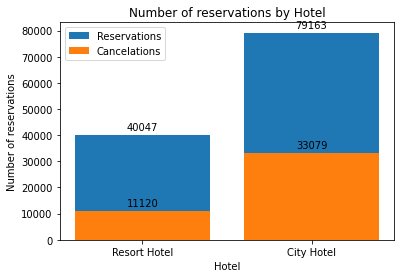

In [78]:
#number of reservations for each hotel

def auto_label(ax, container):
    for c in container:
        height = c.get_height()
        
        ax.annotate('{}'.format(height),
                    xy = (c.get_x() + c.get_width() / 2, height),
                    xytext = (0, 3),  #3 points vertical offset
                    textcoords = 'offset points',
                    ha = 'center', va = 'bottom')

def show_number_reservations():
    dict = []
    
    for hotel in df.hotel.unique():
        dict.append({'hotel' : hotel, 
                     'reservations' : len(df.loc[df.hotel == hotel, 'hotel']), 
                     'cancelations' : len(df.loc[(df.hotel == hotel) & (df.is_canceled == 1), 'hotel'])})
    
    data = pd.DataFrame(dict)
    
    fig, ax = plt.subplots()
    
    reserv_bar = ax.bar(data.hotel, data.reservations, label = 'Reservations')
    cancel_bar = ax.bar(data.hotel, data.cancelations, label = 'Cancelations')
            
    plt.title('Number of reservations by Hotel')
    plt.xlabel('Hotel')
    plt.ylabel('Number of reservations')
    plt.legend()

    auto_label(ax, reserv_bar)
    auto_label(ax, cancel_bar)
    
    return data

show_number_reservations()

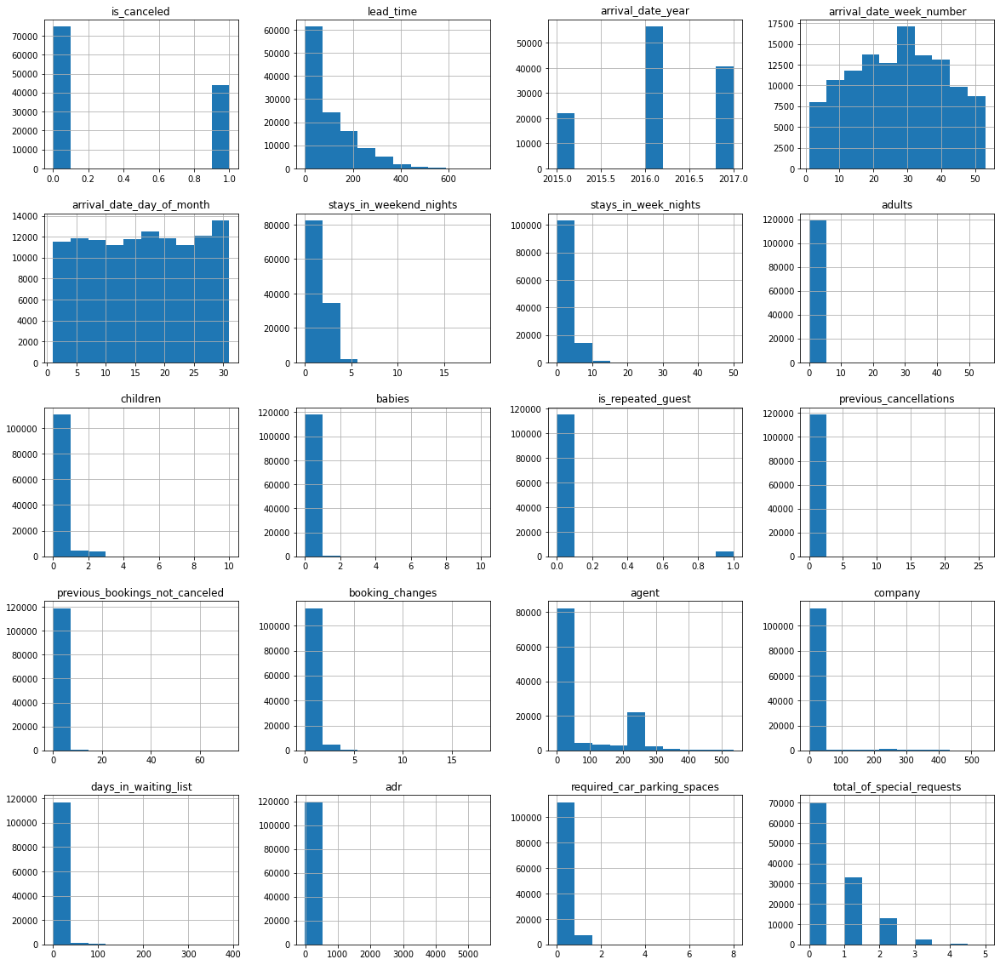

In [79]:
#histograms
df.hist(bins=10,figsize=(20,20))
plt.show()

##From where are most of the guests coming ?

In [80]:
country_wise_guests = df[df['is_canceled'] == 0]['country'].value_counts().reset_index()
country_wise_guests.columns = ['country', 'No of guests']
country_wise_guests

,country,No of guests
0,PRT,20977
1,GBR,9668
2,FRA,8468
3,ESP,6383
4,DEU,6067
...,...,...
161,DJI,1
162,MMR,1
163,BHS,1
164,BDI,1


In [81]:
basemap = folium.Map()
guests_map = px.choropleth(country_wise_guests, locations = country_wise_guests['country'],
                           color = country_wise_guests['No of guests'], hover_name = country_wise_guests['country'])
guests_map.show()

People from all over the world are staying in these two hotels. Most guests are from Portugal and some other countries in Europe.

##Room type 

Both hotels have different room types and different meal arrangements.Hence the prices vary a lot.

In [82]:
data = df[df['is_canceled'] == 0]

px.box(data_frame = data, x = 'reserved_room_type', y = 'adr', color = 'hotel', template = 'plotly_dark')

The above plot shows that the average daily rate depends on the reserved room type and also on the type of hotel (whether it is city or resort).

In [83]:
data_resort = df[(df['hotel'] == 'Resort Hotel') & (df['is_canceled'] == 0)]
data_city = df[(df['hotel'] == 'City Hotel') & (df['is_canceled'] == 0)]

resort_hotel = data_resort.groupby(['arrival_date_month'])['adr'].mean().reset_index()
city_hotel=data_city.groupby(['arrival_date_month'])['adr'].mean().reset_index()

final_hotel = resort_hotel.merge(city_hotel, on = 'arrival_date_month')
final_hotel.columns = ['month', 'price_for_resort', 'price_for_city_hotel']
final_hotel

,month,price_for_resort,price_for_city_hotel
0,April,75.867816,111.962267
1,August,181.205892,118.674598
2,December,68.410104,88.401855
3,February,54.147478,86.520062
4,January,48.761125,82.330983
5,July,150.122528,115.818019
6,June,107.974850,117.874360
7,March,57.056838,90.658533
8,May,76.657558,120.669827
9,November,48.706289,86.946592


In [84]:
!pip install sort-dataframeby-monthorweek

!pip install sorted-months-weekdays

  Created wheel for sort-dataframeby-monthorweek: filename=sort_dataframeby_monthorweek-0.4-py3-none-any.whl size=3439 sha256=193147d3be320d662485821fbc169e345bd5a202ba19fae8025c491eac74707e
  Stored in directory: /root/.cache/pip/wheels/de/e1/ad/5fe265a9780676079c4b8caaaffaa8d5c4ab2f37cf823e8aa8
Successfully built sort-dataframeby-monthorweek
  Created wheel for sorted-months-weekdays: filename=sorted_months_weekdays-0.2-py3-none-any.whl size=3240 sha256=6b0a1bf47b39357e7bb4e6a2fbbe0c468200073aeb04e717227aa9146277a5ae
  Stored in directory: /root/.cache/pip/wheels/4f/4f/78/3f1b8fc72651f7c766a6f73d667fccb12a8aabe240b38df7a4
Successfully built sorted-months-weekdays


In [85]:
import sort_dataframeby_monthorweek as sd

def sort_month(df, column_name):
    return sd.Sort_Dataframeby_Month(df, column_name)

In [86]:
final_prices = sort_month(final_hotel, 'month')
final_prices

,month,price_for_resort,price_for_city_hotel
0,January,48.761125,82.330983
1,February,54.147478,86.520062
2,March,57.056838,90.658533
3,April,75.867816,111.962267
4,May,76.657558,120.669827
5,June,107.974850,117.874360
6,July,150.122528,115.818019
7,August,181.205892,118.674598
8,September,96.416860,112.776582
9,October,61.775449,102.004672


In [87]:
plt.figure(figsize = (17, 8))

px.line(final_prices, x = 'month', y = ['price_for_resort','price_for_city_hotel'],
        title = 'Room price per night over the Months', template = 'plotly_dark')

<Figure size 1224x576 with 0 Axes>

1. This plot clearly shows that prices of  Resort Hotels peak during  August.
2. Prices of City hotels vary less as compared to Resorts

##Which are the most busy months?

In [88]:
resort_guests = data_resort['arrival_date_month'].value_counts().reset_index()
resort_guests.columns=['month','no of guests']

city_guests = data_city['arrival_date_month'].value_counts().reset_index()
city_guests.columns=['month','no of guests']

final_guests = resort_guests.merge(city_guests,on='month')
final_guests.columns=['month','no of guests in resort','no of guest in city hotel']

final_guests = sort_month(final_guests,'month')

final_guests

,month,no of guests in resort,no of guest in city hotel
0,January,1866,2249
1,February,2308,3051
2,March,2571,4049
3,April,2550,4010
4,May,2535,4568
5,June,2037,4358
6,July,3137,4770
7,August,3257,5367
8,September,2102,4283
9,October,2575,4326


In [89]:
pip install plotly --upgrade

  Using cached plotly-5.3.1-py2.py3-none-any.whl (23.9 MB)
  Using cached tenacity-8.0.1-py3-none-any.whl (24 kB)


In [90]:
px.line(final_guests, x = 'month', y = ['no of guests in resort','no of guest in city hotel'],
        title='Total no of guests vs Months', template = 'plotly_dark')

1. The City hotel has more guests than Resorts in general.
2. In August there are a huge number of guests for City hotels, which may be due to prices of Resorts shooting high in August(previous plot shows this). Hence customers would be going for a cheaper option and htherefore choose City hotels 
3. In June there is a larger dip in the visitors of Resort hotels than City hotels.
4. Both hotels have the fewest guests during the winter.


##How long do people stay at the hotels?

In [91]:
filter = df['is_canceled'] == 0
data_where_booking_not_cancelled = df[filter]

data_where_booking_not_cancelled['total_nights'] = data_where_booking_not_cancelled['stays_in_weekend_nights'] 
+ data_where_booking_not_cancelled['stays_in_week_nights']

stay = data_where_booking_not_cancelled.groupby(['total_nights', 'hotel']).agg('count').reset_index()
stay = stay.iloc[:, :3]
stay = stay.rename(columns={'is_canceled':'Number of stays'})
stay

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,total_nights,hotel,Number of stays
0,0,City Hotel,21477
1,0,Resort Hotel,10933
2,1,City Hotel,12868
3,1,Resort Hotel,6740
4,2,City Hotel,11442
5,2,Resort Hotel,9347
6,3,City Hotel,167
7,3,Resort Hotel,641
8,4,City Hotel,106
9,4,Resort Hotel,1144


##Boxplot Distribution of Nights Spent at Hotels by Market Segment and Hotel Type

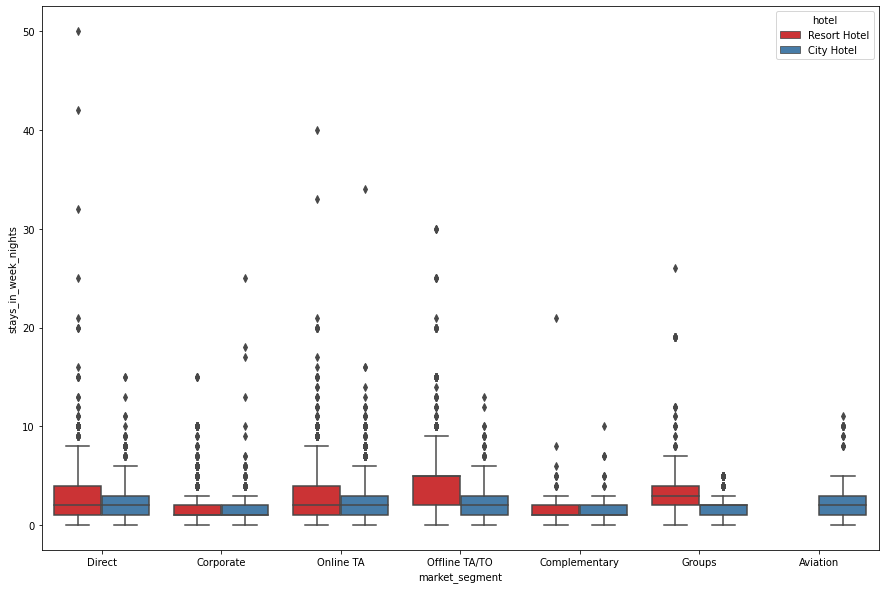

In [92]:
plt.figure(figsize = (15,10))
sns.boxplot(x = "market_segment", y = "stays_in_week_nights", data = data, hue = "hotel", palette = 'Set1')

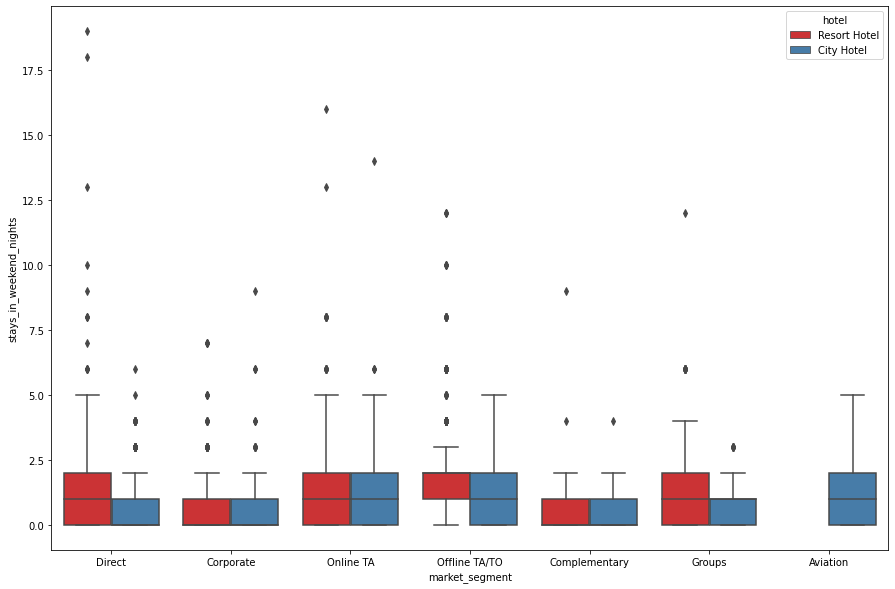

In [93]:
plt.figure(figsize=(15,10))
sns.boxplot(x = "market_segment", y = "stays_in_weekend_nights", data = data, hue = "hotel", palette = 'Set1');

It can be seen that most of the groups are normal distributed, some of them have high skewness. Looking at the distribution, most people do not seem to prefer to stay at the hotel for more than 1 week. But it seems normal to stay in resort hotels for up to 12-13 days. Although this changes according to the segments, staying longer than 15 days certainly creates outliers for each segment. If the total time feature was created by summing up the weekend and week nights, this would be clearer, but it can be clearly seen when looking at the two visualizations together.

As it turns out, customers from Aviation Segment do not seem to be staying at the resort hotels and have a relatively lower day average. Apart from that, the weekends and weekdays averages are roughly equal. Customers in the Aviation Segment are likely to arrive shortly due to business. Also probably most airports are a bit away from sea and its most likely to be closer to city hotels.

It is obvious that when people go to resort hotels, they prefer to stay more.

##Percentage of deposit Type

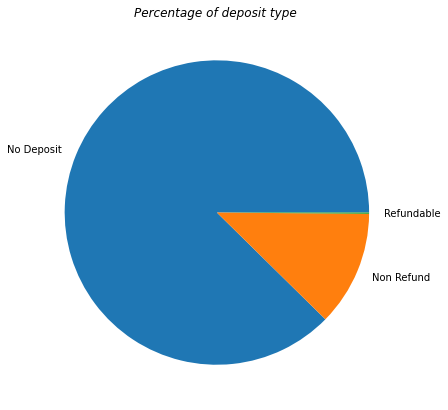

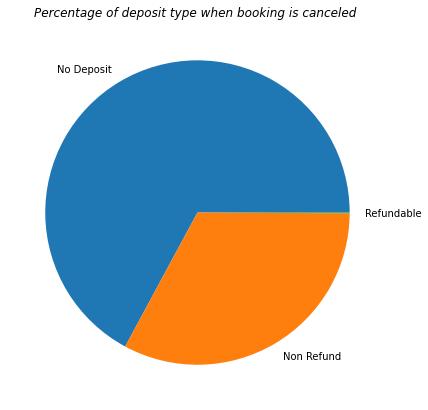

In [94]:
canceled=df[df.is_canceled==1]
All_Deposit_type_counts = df["deposit_type"].value_counts()
#print(Deposit_type_counts)

fig = plt.figure(figsize =(10, 7))
plt.pie(All_Deposit_type_counts.values, labels = All_Deposit_type_counts.keys())
plt.title(label="Percentage of deposit type ",fontstyle='italic')
plt.show()



Canceled_Deposit_type_counts=canceled["deposit_type"].value_counts()

fig = plt.figure(figsize =(10, 7))
plt.pie(Canceled_Deposit_type_counts.values, labels = Canceled_Deposit_type_counts.keys())
plt.title(label="Percentage of deposit type when booking is canceled ", fontstyle='italic')
plt.show()


## 

##Comparison of people's reservations with the babies

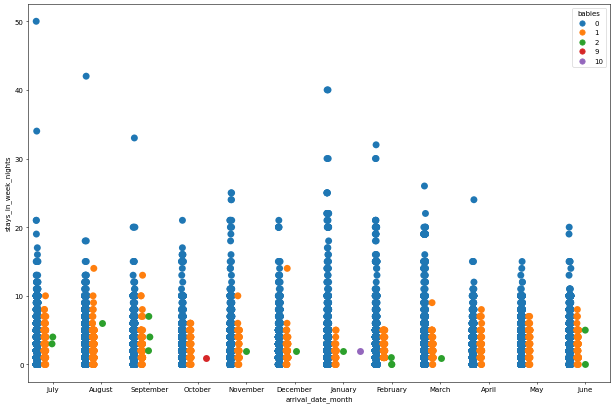

In [95]:
plt.figure(figsize=(15,10), dpi=50)
sns.stripplot(data=df, x='arrival_date_month', y='stays_in_week_nights',hue='babies', jitter=True, dodge=True,size=10)

##Comparing Lead time each year

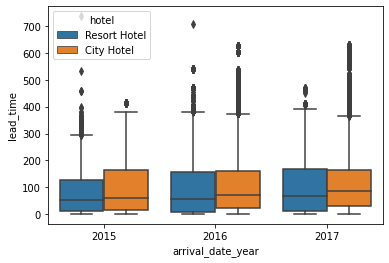

In [96]:
sns.boxplot(data=df, x='arrival_date_year', y='lead_time', hue='hotel')

##How many bookings were canceled?

In [97]:
# absolute cancelations:
total_cancelations = df["is_canceled"].sum()
rh_cancelations = df.loc[df["hotel"] == "Resort Hotel"]["is_canceled"].sum()
ch_cancelations = df.loc[df["hotel"] == "City Hotel"]["is_canceled"].sum()

# as percent:
rel_cancel = total_cancelations / df.shape[0] * 100
rh_rel_cancel = rh_cancelations / df.loc[df["hotel"] == "Resort Hotel"].shape[0] * 100
ch_rel_cancel = ch_cancelations / df.loc[df["hotel"] == "City Hotel"].shape[0] * 100

print(f"Total bookings canceled: {total_cancelations:,} ({rel_cancel:.0f} %)")
print(f"Resort hotel bookings canceled: {rh_cancelations:,} ({rh_rel_cancel:.0f} %)")
print(f"City hotel bookings canceled: {ch_cancelations:,} ({ch_rel_cancel:.0f} %)")

Total bookings canceled: 44,199 (37 %)
Resort hotel bookings canceled: 11,120 (28 %)
City hotel bookings canceled: 33,079 (42 %)


##Arrival months vs cancellations happening in that month

In [98]:
month_sorted = ['January','February','March','April','May','June','July','August','September','October','November','December']

In [99]:
new= pd.DataFrame(df.groupby('arrival_date_month').sum(),columns = ['is_canceled'])
new.reset_index(inplace=True)

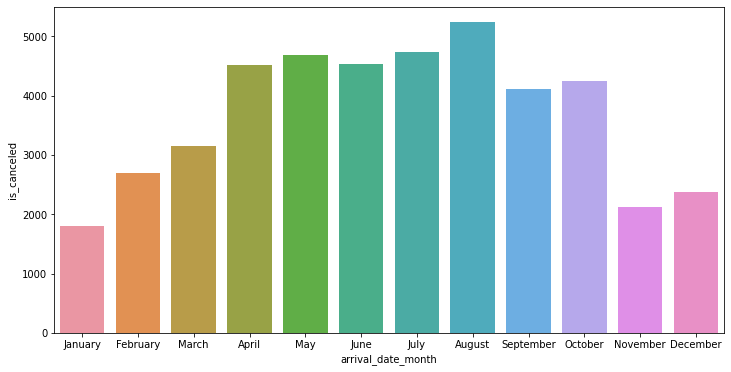

In [100]:
fig, ax = plt.subplots(figsize = (12,6))    
fig = sns.barplot(x='arrival_date_month',y='is_canceled',data=new, 
                  estimator = sum, ci = None, ax=ax,order=month_sorted)

##Comparing total bookings and cancellations each Hotel

Text(0.5, 1.0, 'Cancelation rates in City hotel and Resort hotel')

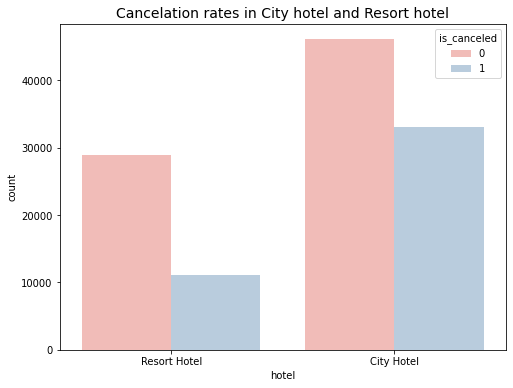

In [101]:
plt.figure(figsize=(8,6))

sns.countplot(x='hotel',hue='is_canceled',data=df,palette='Pastel1')
plt.title('Cancelation rates in City hotel and Resort hotel',fontsize=14)

##Average daily rate and months

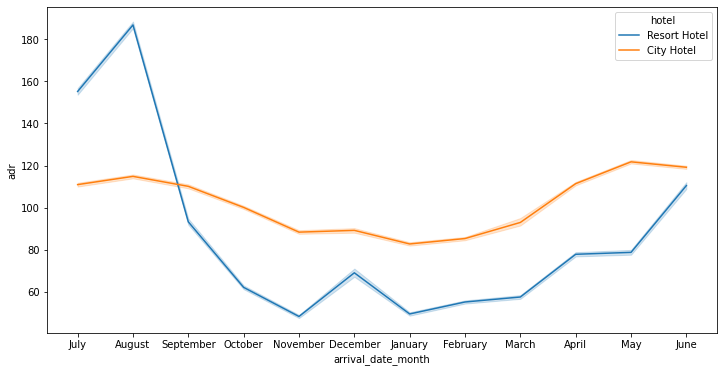

In [102]:
plt.figure(figsize=(12,6))
sns.lineplot(x='arrival_date_month', y='adr', hue='hotel', data= df)
plt.show()

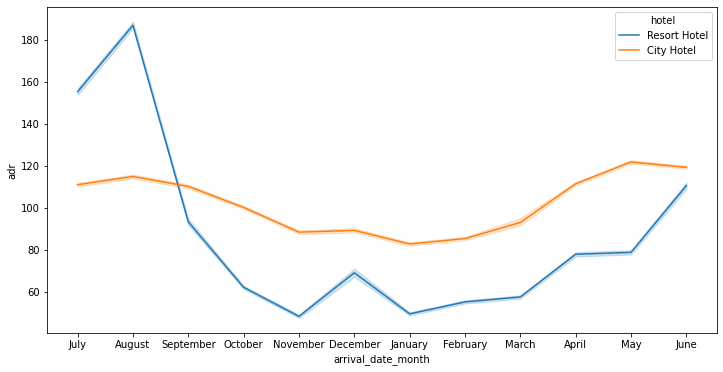

In [103]:
plt.figure(figsize=(12,6))
sns.lineplot(x='arrival_date_month', y='adr', hue='hotel', data= df)
plt.show()

##Arrivals in month

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



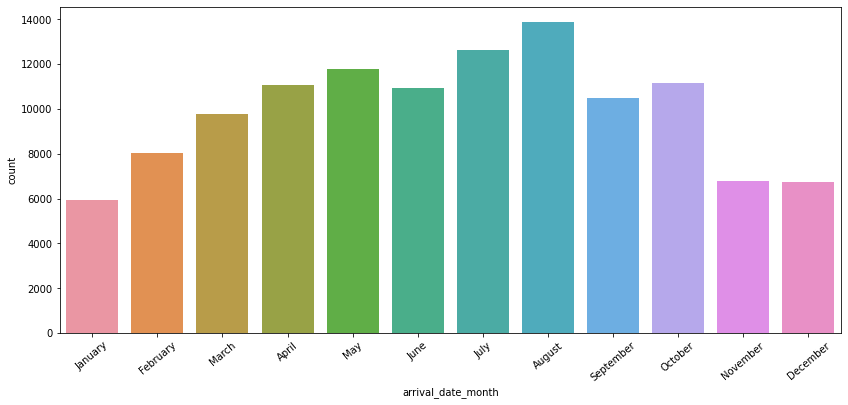

In [104]:
plt.figure(figsize=(14,6))
sns.countplot(df['arrival_date_month'], order = month_sorted)
plt.xticks(rotation = 40)
plt.show()

We can see most bookings were done in the month of August,July,May

##Lead Time for Cancelling and non_cancelling in the years

Text(0.5, 1.0, 'Arriving year, Leadtime and Cancelations')

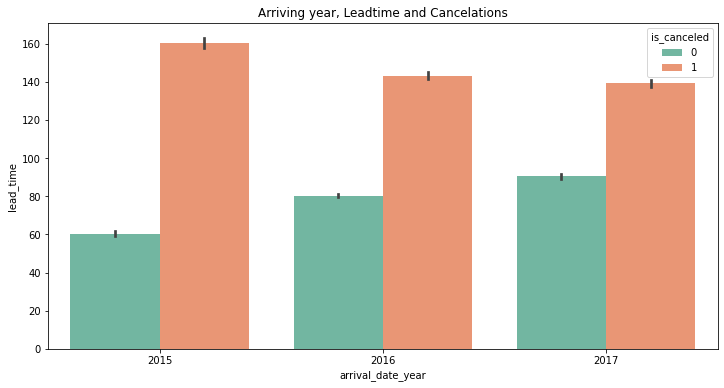

In [105]:
country_10=pd.DataFrame(df['country'].value_counts()[:10])
country_10.reset_index(inplace=True)
plt.figure(figsize=(12,6))
sns.barplot(x='arrival_date_year', y='lead_time',hue='is_canceled', data= df, palette='Set2')
plt.title('Arriving year, Leadtime and Cancelations')

##Which country has the most cancellations?

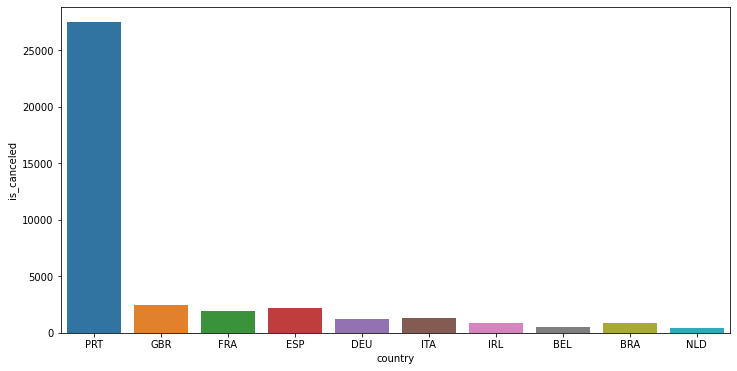

In [106]:
fig, ax = plt.subplots(figsize = (12,6))    
fig = sns.barplot(x='country',y='is_canceled',data=df, 
                  estimator = sum, ci = None, ax=ax,order=country_10['index'])

##Compare total bookings & cancellations each month

In [107]:
def change_width(ax, new_value,recenter=False) :
    for patch in ax.patches :
        current_width = patch.get_width()
        diff = current_width - new_value
        patch.set_width(new_value)
        if recenter==True:  
            patch.set_x(patch.get_x() + diff * .5) #To recenter the bars

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



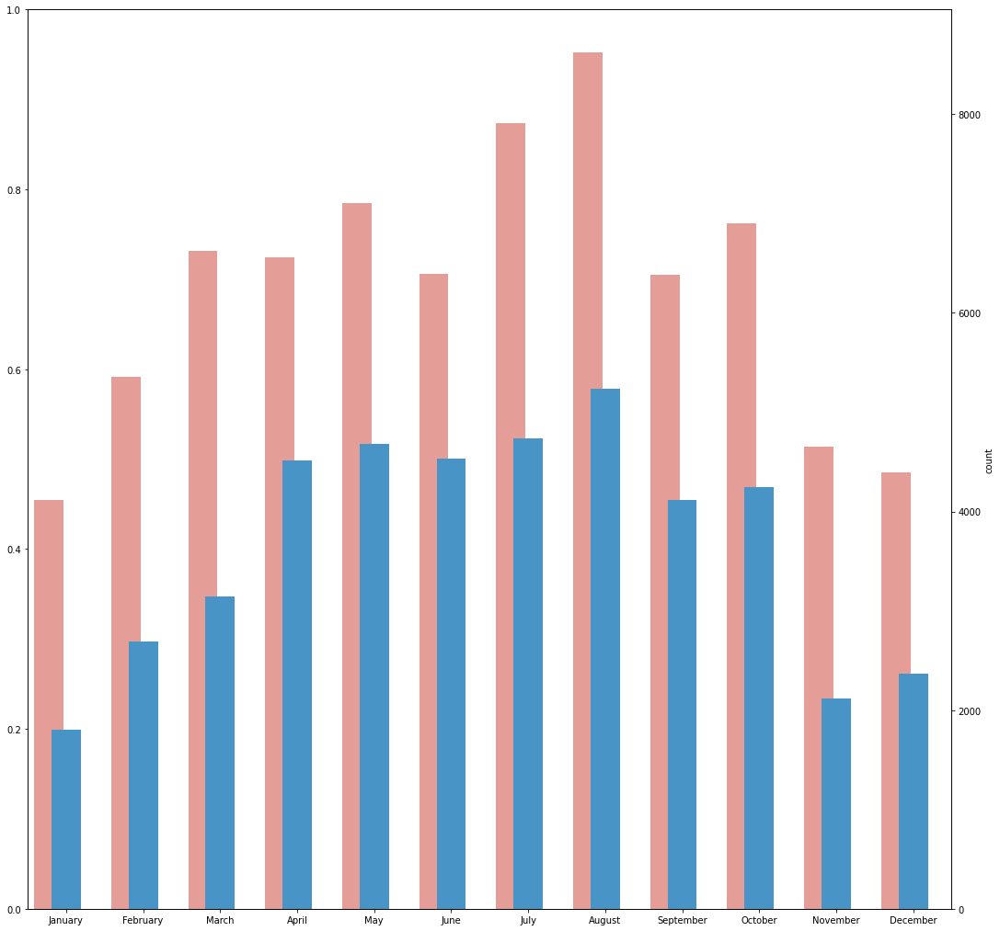

In [108]:
fig , ax1=plt.subplots(1,1,figsize=(18,18))
ax2=ax1.twinx()

ax1=sns.countplot(df[df['is_canceled']==0]['arrival_date_month'], color='#F1948A', order = month_sorted)

change_width(ax1, 0.35)

ax2=sns.countplot(df[df['is_canceled']==1]['arrival_date_month'], color='#3498DB',order = month_sorted)
# ax2.legend('is_canceled')
change_width(ax2, 0.38,True)

##Cancellations by repeated guests

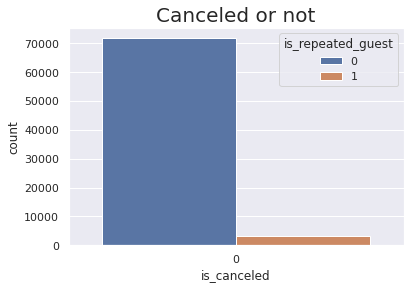

In [109]:
sns.set(style = "darkgrid")
plt.title("Canceled or not", fontdict = {'fontsize': 20})
ax = sns.countplot(x = "is_canceled", hue = 'is_repeated_guest', data = data)

There is no surprise that repeated guests do not cancel their reservations. Of course there are some exceptions. Also most of the customers are not repeated guests.

#CORRELATION ANALYSIS AND FEATURE SCALING

In [110]:
from sklearn.preprocessing import LabelEncoder

In [111]:
profile=pp.ProfileReport(df,title="Hotel Booking Dataset",html={'style':{'full_width':True}})

In [112]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

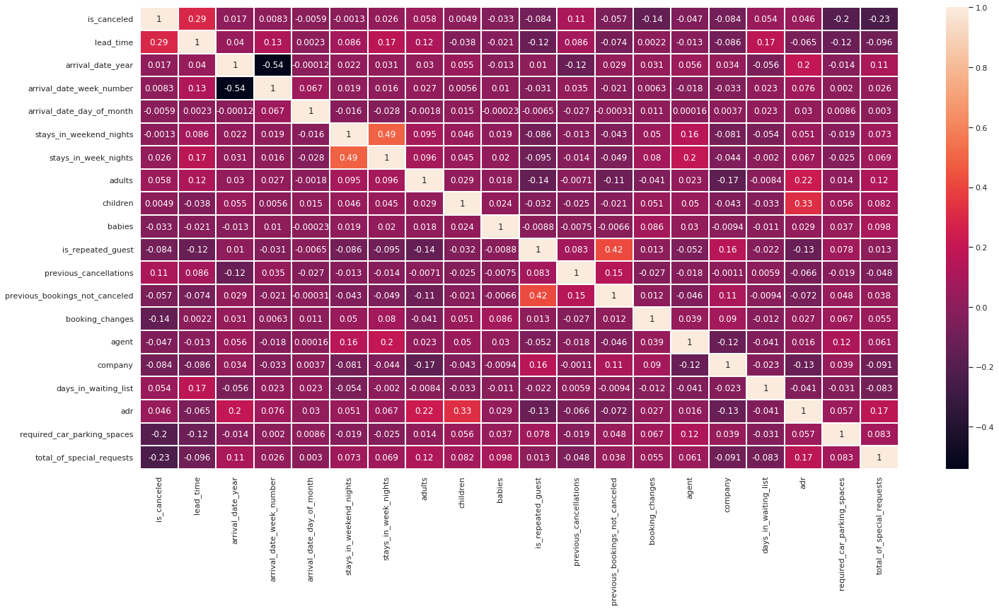

In [113]:
plt.figure(figsize = (24, 12))

corr = df.corr()
sns.heatmap(corr, annot = True, linewidths = 1)
plt.show()

In [114]:
df.corr()['is_canceled'].abs().sort_values(ascending = False)

is_canceled                       1.000000
lead_time                         0.292876
total_of_special_requests         0.234877
required_car_parking_spaces       0.195701
booking_changes                   0.144832
previous_cancellations            0.110139
is_repeated_guest                 0.083745
company                           0.083594
adults                            0.058182
previous_bookings_not_canceled    0.057365
days_in_waiting_list              0.054301
agent                             0.046770
adr                               0.046492
babies                            0.032569
stays_in_week_nights              0.025542
arrival_date_year                 0.016622
arrival_date_week_number          0.008315
arrival_date_day_of_month         0.005948
children                          0.004851
stays_in_weekend_nights           0.001323
Name: is_canceled, dtype: float64

The first 5 variables (lead_time, total_of_special_requests, required_car_parking_spaces, booking_changes, previous_cancellations) are the ones with correlation > 0.10 for is_canceled.

##But let us now analyse categorical variables (as the able correlation matrix displays only numerical features):

Categorical labels will be converted into numerical form which will be more understandable and implementable into machine learning algorithms. Some features are not ordinal such as country. In that case, One-Hot Encoding could be chosen. Due to the high number of categories, this method could incur higher computational cost. To help reducing that, Label Encoding method will be used.

In [115]:
#Using Label Encoder method for categorical features

labelencoder = LabelEncoder()
df['hotel'] = labelencoder.fit_transform(df['hotel'])
df['arrival_date_month'] = labelencoder.fit_transform(df['arrival_date_month'])
df['meal'] = labelencoder.fit_transform(df['meal'])
df['country'] = labelencoder.fit_transform(df['country'])
df['market_segment']= labelencoder.fit_transform(df['market_segment'])
df['distribution_channel']=labelencoder.fit_transform(df['distribution_channel'])
df['is_repeated_guest'] = labelencoder.fit_transform(df['is_repeated_guest'])
df['reserved_room_type'] = labelencoder.fit_transform(df['reserved_room_type'])
df['assigned_room_type'] = labelencoder.fit_transform(df['assigned_room_type'])
df['deposit_type'] = labelencoder.fit_transform(df['deposit_type'])
df['agent'] = labelencoder.fit_transform(df['agent'])
df['customer_type'] = labelencoder.fit_transform(df['customer_type'])
df['reservation_status'] = labelencoder.fit_transform(df['reservation_status'])

After encoding the categorical data, two data frames will be created. One data frame has only categorical data and another has numerical data. These two different data frames will be used to create a correlation matrix. Spearman method will be used for categorical data correlation matrix and Pearson method will be used for numerical one.

In [116]:
#Create new dataframe for categorical data

df_categorical = df[['hotel','is_canceled','arrival_date_month','meal',
                                     'country','market_segment','distribution_channel', 
                                     'is_repeated_guest', 'reserved_room_type',
                                     'assigned_room_type','deposit_type','agent',
                                     'customer_type','reservation_status']] 

In [117]:
df_numerical = df.drop(columns = df_categorical.columns, axis = 1)

In [118]:
df_categorical.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 119210 entries, 0 to 119389
Data columns (total 14 columns):
 #   Column                Non-Null Count   Dtype
---  ------                --------------   -----
 0   hotel                 119210 non-null  int64
 1   is_canceled           119210 non-null  int64
 2   arrival_date_month    119210 non-null  int64
 3   meal                  119210 non-null  int64
 4   country               119210 non-null  int64
 5   market_segment        119210 non-null  int64
 6   distribution_channel  119210 non-null  int64
 7   is_repeated_guest     119210 non-null  int64
 8   reserved_room_type    119210 non-null  int64
 9   assigned_room_type    119210 non-null  int64
 10  deposit_type          119210 non-null  int64
 11  agent                 119210 non-null  int64
 12  customer_type         119210 non-null  int64
 13  reservation_status    119210 non-null  int64
dtypes: int64(14)
memory usage: 18.6 MB


In [119]:
df_numerical.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 119210 entries, 0 to 119389
Data columns (total 18 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   lead_time                       119210 non-null  int64  
 1   arrival_date_year               119210 non-null  int64  
 2   arrival_date_week_number        119210 non-null  int64  
 3   arrival_date_day_of_month       119210 non-null  int64  
 4   stays_in_weekend_nights         119210 non-null  int64  
 5   stays_in_week_nights            119210 non-null  int64  
 6   adults                          119210 non-null  int64  
 7   children                        119210 non-null  float64
 8   babies                          119210 non-null  int64  
 9   previous_cancellations          119210 non-null  int64  
 10  previous_bookings_not_canceled  119210 non-null  int64  
 11  booking_changes                 119210 non-null  int64  
 12  company         

Text(0.5, 1.0, 'Correlation Matrix Spearman Method- Categorical Data ')

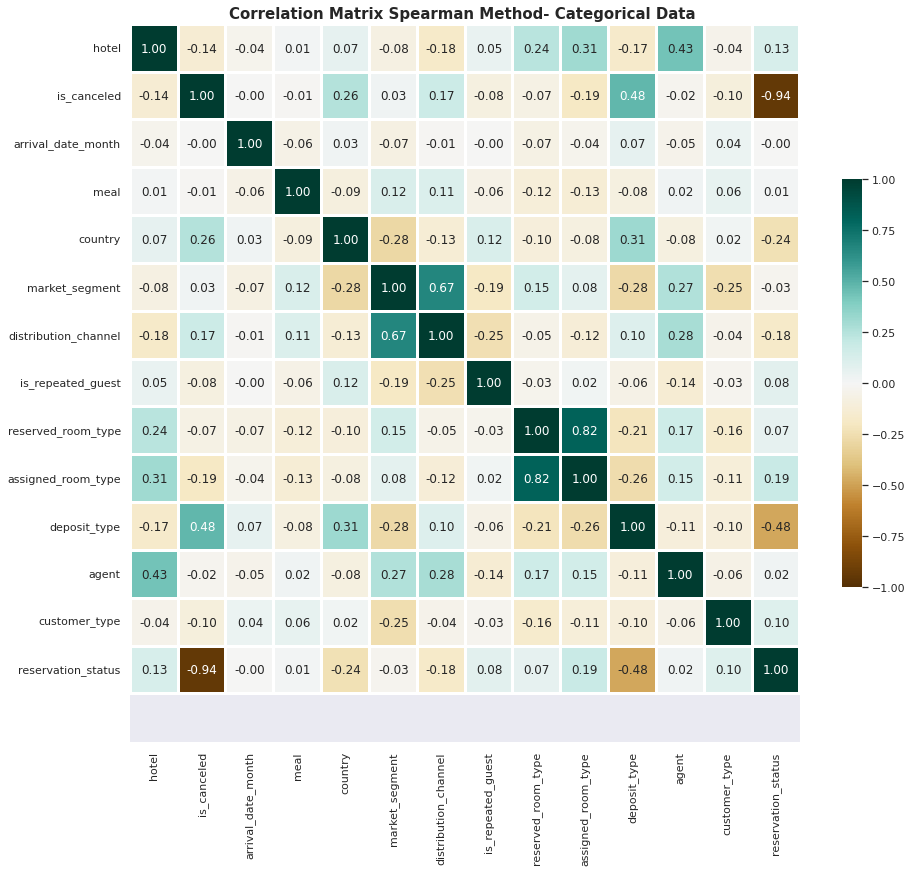

In [120]:
# Correlation Matrix with Spearman method

plt.figure(figsize=(15,15))
corr_categorical=df_categorical.corr(method='spearman')
mask_categorical = np.triu(np.ones_like(corr_categorical, dtype=np.bool))
sns.heatmap(corr_categorical, annot=True, fmt=".2f", cmap='BrBG', vmin=-1, vmax=1, center= 0,
            square=True, linewidths=2, cbar_kws={"shrink": .5}).set(ylim=(15, 0))
plt.title("Correlation Matrix Spearman Method- Categorical Data ",size=15, weight='bold')

Text(0.5, 1.0, 'Correlation Matrix Pearson Method- Numerical Data ')

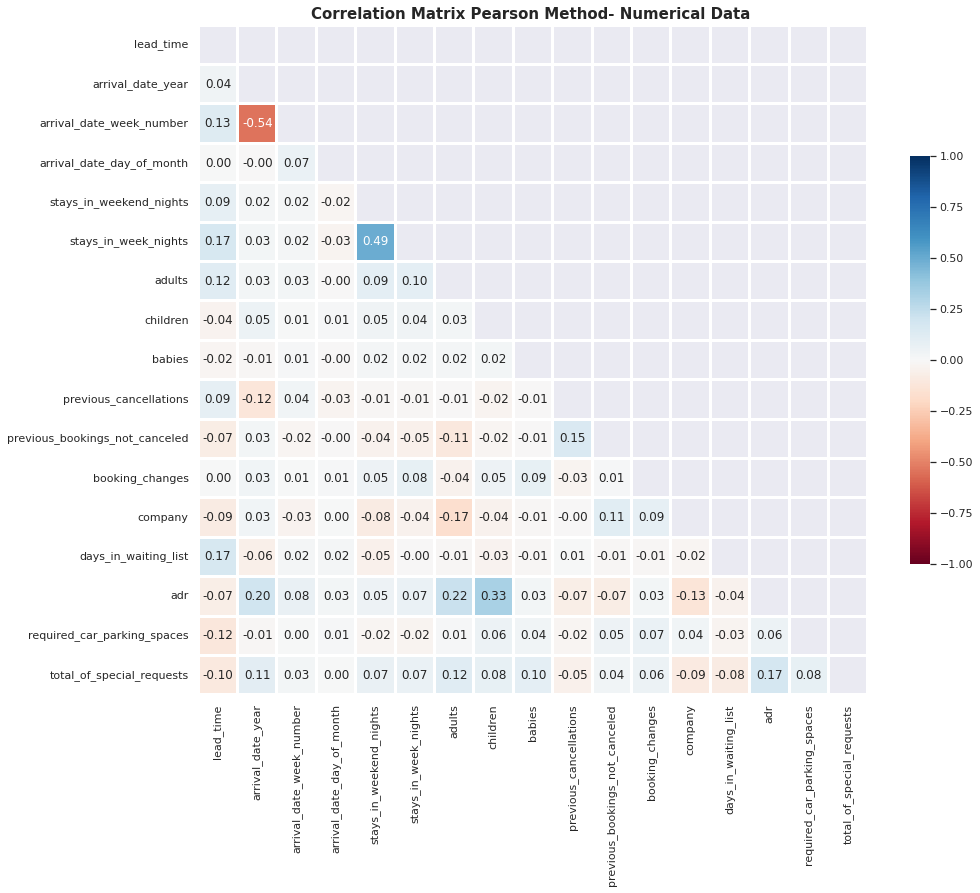

In [121]:
# Correlation Matrix with pearson method

plt.figure(figsize=(15,15))
corr_numerical=df_numerical.corr(method='pearson')
mask_numerical = np.triu(np.ones_like(corr_numerical, dtype=np.bool))
sns.heatmap(corr_numerical, annot=True, fmt=".2f", cmap='RdBu', mask= mask_numerical, vmin=-1, vmax=1, center= 0,
            square=True, linewidths=2, cbar_kws={"shrink": .5}).set(ylim=(17, 0))
plt.title("Correlation Matrix Pearson Method- Numerical Data ",size=15, weight='bold')

In those two heatmaps, the reservation_ status feature is drawn more attention because of its negative correlation with the is_canceled feature. The below table shows the relationship with details. This high correlation can cause a wrong prediction or overfitting. Prevent this situation, reservation_status feature will be eliminated.

Last feature is reservation_status_date. Since this feature includes date type date and it could not convert another type, this feature will be eliminated.

In [122]:
#Dropping some features from data

df = df.drop(['reservation_status', 'reservation_status_date'], axis=1)

##Hyperparameter Tunning and Feature Importance

In [123]:
from xgboost import XGBClassifier

In [124]:
from sklearn.inspection import permutation_importance

In [125]:
# Seperate target variable

df_tunning = df
y = df_tunning.iloc[:,1]
X = pd.concat([df_tunning.iloc[:,0],df_tunning.iloc[:,2:30]], axis=1)

In [126]:
# Permutation Importance graph with XGB Classifier algorithm.

params = {
    'criterion': 'giny', 
    'learning_rate': 0.01, 
    'max_depth': 5,
    'n_estimators': 100, 
    'objective': 'binary:logistic', 
}
model = XGBClassifier(parameters=params)
# fit the model
model.fit(X, y)
# perform permutation importance
result = permutation_importance(model, X, y, scoring='accuracy', n_repeats = 5, n_jobs=-1)
sorted_idx = result.importances_mean.argsort()

/usr/local/lib/python3.7/site-packages/xgboost/sklearn.py:1224: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[11:08:47] WARNING: ../src/learner.cc:576: 
Parameters: { "parameters" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[11:08:47] WARNING: ../src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [127]:
# Feature scores table

for i,v in enumerate(sorted_idx):
    print('Feature: %0d, Score: %.5f' % (i,v))

Feature: 0, Score: 10.00000
Feature: 1, Score: 23.00000
Feature: 2, Score: 9.00000
Feature: 3, Score: 8.00000
Feature: 4, Score: 0.00000
Feature: 5, Score: 24.00000
Feature: 6, Score: 6.00000
Feature: 7, Score: 14.00000
Feature: 8, Score: 11.00000
Feature: 9, Score: 3.00000
Feature: 10, Score: 15.00000
Feature: 11, Score: 7.00000
Feature: 12, Score: 5.00000
Feature: 13, Score: 17.00000
Feature: 14, Score: 20.00000
Feature: 15, Score: 4.00000
Feature: 16, Score: 26.00000
Feature: 17, Score: 27.00000
Feature: 18, Score: 25.00000
Feature: 19, Score: 2.00000
Feature: 20, Score: 16.00000
Feature: 21, Score: 13.00000
Feature: 22, Score: 19.00000
Feature: 23, Score: 18.00000
Feature: 24, Score: 28.00000
Feature: 25, Score: 1.00000
Feature: 26, Score: 22.00000
Feature: 27, Score: 21.00000
Feature: 28, Score: 12.00000


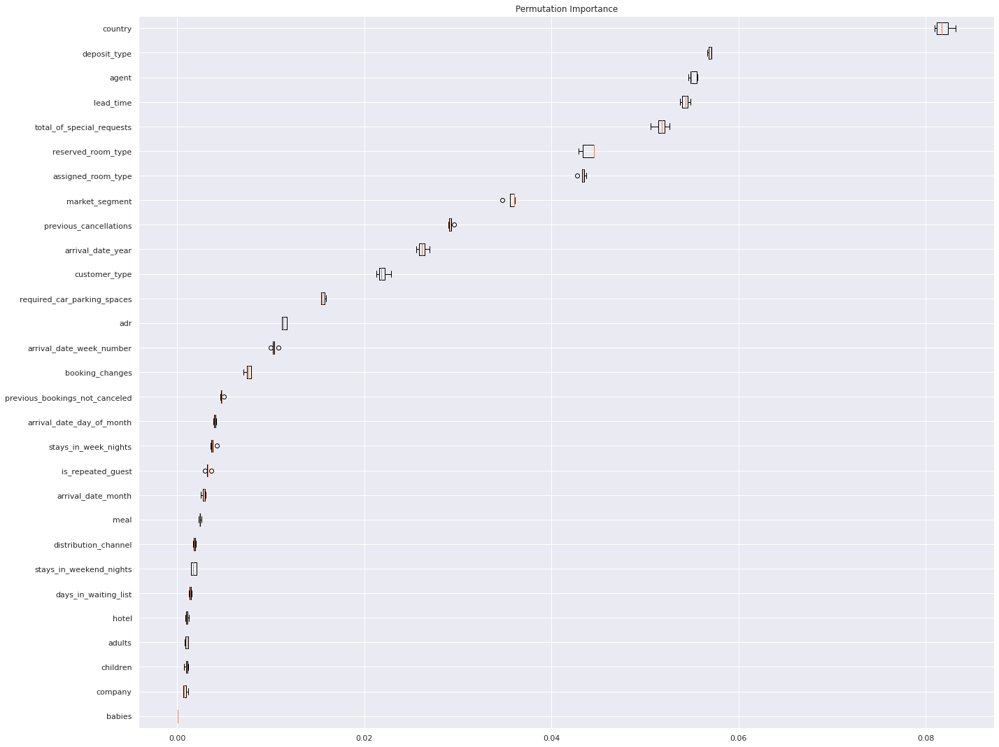

In [128]:
#Permutation Importance graph 

fig, ax = plt.subplots(figsize=(20,15))

ax.boxplot(result.importances[sorted_idx].T,
           vert=False, labels=X.columns[sorted_idx])
ax.set_title("Permutation Importance")
fig.tight_layout()
plt.show()

1 out of 29 features are not being important to prediction which is babies. It will eliminated.

In [129]:
# Drop `baby` feature from data

df = df.drop(['babies'], axis=1)

In [130]:
df.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 119210 entries, 0 to 119389
Data columns (total 29 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119210 non-null  int64  
 1   is_canceled                     119210 non-null  int64  
 2   lead_time                       119210 non-null  int64  
 3   arrival_date_year               119210 non-null  int64  
 4   arrival_date_month              119210 non-null  int64  
 5   arrival_date_week_number        119210 non-null  int64  
 6   arrival_date_day_of_month       119210 non-null  int64  
 7   stays_in_weekend_nights         119210 non-null  int64  
 8   stays_in_week_nights            119210 non-null  int64  
 9   adults                          119210 non-null  int64  
 10  children                        119210 non-null  float64
 11  meal                            119210 non-null  int64  
 12  country         